# Задание 1. Создайте U-Net-подобную сеть для сегментации документов

In [ ]:
torch.cuda.empty_cache()

In [ ]:
import gc
gc.collect()

30

В качастве датасета используется фрагмент [midv500](https://arxiv.org/abs/1807.05786). Это датасет, содержащий фотографии документов, таких как паспорт или водительское удостоверение.

Подзадачи:
- Загрузить данные
- Описать модель
- Убедитесь что модель выполняется





Импорт необходимых библиотек:

In [ ]:
import os
import glob
import torch
import numpy as np
import matplotlib.pyplot as plt

from torch import nn
from PIL import Image
from torchsummary import summary
from torchvision import tv_tensors
from torchvision.io import read_image
from torchvision.transforms import v2
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader

## Загрузка данныx







In [ ]:
#! wget -N http://fmb.images.gan4x4.ru/hse/midv500p.zip
! wget -qN https://edunet.kea.su/repo/EduNet-web_dependencies/datasets/midv500p.zip
! unzip -q midv500p.zip
! rm midv500p.zip

Класс `MaskDataset` возвращает часть датасета для обучения при `train_part == True` и тестовую часть при `train_part == False`.

Каждый экземпляр датасета состоит из двух изображений: входного изображения и размеченной маски.

In [ ]:
from torchvision import tv_tensors
from PIL import Image, ImageFile
from torchvision.io import read_image

# To bypass error on corrupted files: https://stackoverflow.com/questions/12984426/pil-ioerror-image-file-truncated-with-big-images
# ImageFile.LOAD_TRUNCATED_IMAGES = False


class MaskDataset(Dataset):
    def __init__(
        self,
        train_part=True,
        transform=None,  # for image only
        transforms=None,  # for image and mask
        target_transform=None,  # for mask only
        path="midv500p",
    ):
        self.transform = transform
        self.transforms = transforms
        self.target_transform = target_transform
        path += "/train" if train_part else "/val"
        files = glob.glob(path + "/image/*")
        self.loaded_images = []
        self.loaded_masks = []

        for filename in files:  # cache all data in memory
            self.loaded_images.append(read_image(filename) / 255)
            mask_fn = filename.replace("image", "mask").replace("jpg", "png")
            self.loaded_masks.append(read_image(mask_fn) / 255)

    def __getitem__(self, i):
        img = self.loaded_images[i]
        mask = self.loaded_masks[i]
        if self.transform is not None:
            img = self.transform(img)
        if self.transforms is not None:
            img, mask = self.transforms(tv_tensors.Image(img), tv_tensors.Mask(mask))
        if self.target_transform is not None:
            mask = self.target_transform(mask)
        return img, mask

    def __len__(self):
        return len(self.loaded_images)

Подумайте, какие аугментации/нормализации приемлемы, и примените их (в baseline-классе применяется одинаковая аугментация для изображения и для маски).

P.S. Допускается использовать библиотеку [albumentations](https://github.com/albumentations-team/albumentations).

In [ ]:
from torchvision.transforms import v2


v2_transforms = v2.Compose(
    [
        v2.Resize((224, 224), antialias=True),  # antialias to suppress warning
        v2.ToDtype(torch.float32, scale=True),
    ]
)


trainset = MaskDataset(train_part=True, transforms=v2_transforms)
valset = MaskDataset(train_part=False, transforms=v2_transforms)

train_loader = DataLoader(trainset, batch_size=32, shuffle=True, num_workers=2)
val_loader = DataLoader(valset, batch_size=4, shuffle=False, num_workers=2)

Убедитесь, что код работает. Для этого воспользуйтесь приведенным ниже тестом.

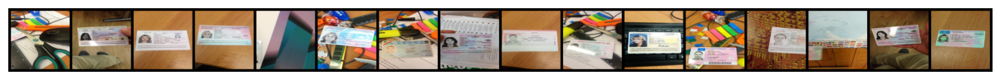

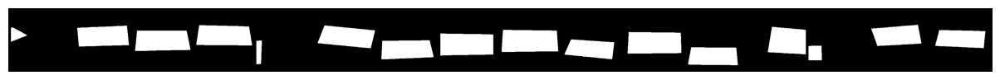

In [ ]:
def show(batch, cols=16):
    cols = min(cols, len(batch))
    img_grid = make_grid(batch[:cols], padding=10, nrow=cols)
    plt.figure(figsize=(cols, 1))
    plt.axis("off")
    plt.imshow(np.transpose((img_grid * 255).numpy().astype(np.uint8), (1, 2, 0)))


images, masks = next(iter(train_loader))

show(images)
show(masks)

## Модель

Опишите структуру  модели.

Рекомендуется использовать [UNet](https://arxiv.org/pdf/1505.04597.pdf)-подобную архитектуру.

Однако вы можете ограничиться 2–3-мя сжимающими и таким  же количеством разжимающих слоев.


In [ ]:
class MiniUnet(nn.Module):
    def __init__(self):
        super().__init__()
        # Your code here

        self.inc1 = nn.Sequential(
            nn.Conv2d(3, 112, kernel_size=3, padding=1),
            nn.ReLU(),
        )
        self.inc2 = nn.Sequential(
            nn.Conv2d(112, 112, kernel_size=3, padding=1),
            nn.ReLU(),
        )
        self.pool = nn.MaxPool2d(kernel_size=2, return_indices=True)

        self.down1 = nn.Sequential(
            nn.Conv2d(112, 112, kernel_size=3, padding=1),
            nn.ReLU(),
        )
        self.down2 = nn.Sequential(
            nn.Conv2d(112, 224, kernel_size=3, padding=1),
            nn.ReLU(),
        )
        self.down3 = nn.Sequential(
            nn.Conv2d(224, 112, kernel_size=3, padding=1),
            nn.ReLU(),
        )

        #self.up1 = nn.Sequential(
        #    nn.Upsample(scale_factor=2),
        #    nn.Conv2d(112, 112, kernel_size=3, padding=1),
        #    nn.ReLU(),
        #)
        self.unpool = nn.MaxUnpool2d(kernel_size=2)

        self.up1 = nn.Sequential(
            nn.Conv2d(224, 112, kernel_size=3, padding=1),
            nn.ReLU(),
        )
        self.up2 = nn.Sequential(
            nn.Conv2d(112, 112, kernel_size=3, padding=1),
            nn.ReLU(),
        )
        self.outc = nn.Conv2d(112, 1, kernel_size=1)

    def forward(self, x):
        # Your code here
        out_inc1 = self.inc1(x) # 224
        out_inc2 = self.inc2(out_inc1) # 224
        out_pool2, idx = self.pool(out_inc2) #112
        out_down1 = self.down1(out_pool2) # 112
        out_down2 = self.down2(out_down1)
        out_down3 = self.down3(out_down2)
        out_unp = self.unpool(out_down3, idx)
        #out_up1 = self.up1(out_unp)
        out_cat1 = torch.cat((out_unp, out_inc2), dim=1)
        out_up1 = self.up1(out_cat1)
        out_up2 = self.up2(out_up1)
        out = self.outc(out_up2)

        return out  # Segmentation mask

Проверим нашу модель:

In [ ]:
from torchsummary import summary

model = MiniUnet()
summary(model, (3, 224, 224), device="cpu")

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1        [-1, 112, 224, 224]           3,136
              ReLU-2        [-1, 112, 224, 224]               0
            Conv2d-3        [-1, 112, 224, 224]         113,008
              ReLU-4        [-1, 112, 224, 224]               0
         MaxPool2d-5  [[-1, 112, 112, 112], [-1, 112, 112, 112]]               0
            Conv2d-6        [-1, 112, 112, 112]         113,008
              ReLU-7        [-1, 112, 112, 112]               0
            Conv2d-8        [-1, 224, 112, 112]         226,016
              ReLU-9        [-1, 224, 112, 112]               0
           Conv2d-10        [-1, 112, 112, 112]         225,904
             ReLU-11        [-1, 112, 112, 112]               0
      MaxUnpool2d-12        [-1, 112, 224, 224]               0
           Conv2d-13        [-1, 112, 224, 224]         225,904
             ReLU-14  

## Формат результата

Вывод torchsummary без ошибок:

```
  ----------------------------------------------------------------
          Layer (type)               Output Shape         Param #
  ================================================================

  ....

  ================================================================
  Total params:
  
  ...

```


# Задание 2. Обучите модель, используя Lightning

- В качестве loss можно использовать BCE ([BCELoss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html), [BCEWithLogitsLoss](https://pytorch.org/docs/stable/generated/torch.nn.BCEWithLogitsLoss.html)), IoU, Dice или их комбинацию.
- Убедитесь, что модель обучается.
- Вычислите метрику качества на валидационной выборке (например, [IoU](https://en.wikipedia.org/wiki/Jaccard_index)).


\*Рекомендуется использовать одну из библиотек для работы с метриками, перечисленных в лекции.

Установка и импорт необходимых библиотек:

In [ ]:
!pip install -q lightning segmentation-models-pytorch

In [ ]:
import torch
import torchvision
import lightning as L


Чтобы было удобно работать с метриками из SMP библиотеки, напишем для нее класс -адаптер:

In [ ]:
from segmentation_models_pytorch.metrics import get_stats


class SMPMetricAdapter:
    values = None

    def __init__(self, metric):
        self.reset()
        self.metric = metric

    def compute(self):
        return torch.Tensor(self.values).mean()

    def update(self, pred, gt):
        pred = pred.cpu().sigmoid()
        gt = gt.cpu().long()
        tp, fp, fn, tn = get_stats(pred, gt, mode="binary", threshold=0.5)
        metric_val = self.metric(tp, fp, fn, tn, reduction="micro")
        self.values.append(metric_val)

    def reset(self):
        self.values = []

Теперь свою метрику можно создать так:

In [ ]:
from segmentation_models_pytorch.metrics import iou_score

iou_from_smp = SMPMetricAdapter(iou_score)

В этом блоке разместите код для обучения

In [ ]:
from pytorch_lightning.loggers import TensorBoardLogger
logger = TensorBoardLogger(save_dir='./logs', name='my_model')

In [ ]:
import segmentation_models_pytorch as smp

In [ ]:
import lightning as L
from torch import optim
import torchmetrics

class LitBasic(L.LightningModule):
    def __init__(self, model):
        super().__init__()
        self.model = model
        #self.metric = smp.losses.JaccardLoss(smp.losses.MULTILABEL_MODE, from_logits=True)
        #self.val_metric = smp.losses.JaccardLoss(smp.losses.MULTILABEL_MODE, from_logits=True)
        self.criterion = nn.BCEWithLogitsLoss()
        # Your code here

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.model.parameters(), lr=1e-3)# Your code here
        return optimizer

    def training_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss_train = self.criterion(out, y)
        #self.metric.update(out, y)
        self.log("loss_train", loss_train, prog_bar = True)
        return loss_train

    def validation_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss_val = self.criterion(out, y)
        #self.val_metric.update(out, y)
        #self.valid_acc.update(preds, labels)
        self.log('loss_val', loss_val)

    #def on_train_epoch_end(self):
       # self.log('train_acc', self.metric.compute(), prog_bar=True)
       # self.metric.reset()

    #def on_validation_epoch_end(self):
        #self.log('valid_acc', self.val_metric.compute(), prog_bar=True)
        #self.val_metric.reset()


In [ ]:
images.shape

torch.Size([32, 3, 224, 224])

In [ ]:
masks.shape

torch.Size([32, 1, 224, 224])

In [ ]:
# Your code here
L.seed_everything(42)
model_miniunet = MiniUnet()
lit_model_miniunet = LitBasic(model_miniunet)
trainer = L.Trainer(logger=logger, max_epochs=15, log_every_n_steps=2)
trainer.fit(model=lit_model_miniunet, train_dataloaders=train_loader, val_dataloaders=val_loader)

INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type              | Params
------------------------------------------------
0 | model     | MiniUnet          | 1.0 M 
1 | criterion | BCEWithLogitsLoss | 0     
------------------------------------------------
1.0 M     Trainable params
0         Non-trainable params
1.0 M     Total params
4.080     Total estimated model params size (MB)
INFO:lightning.pytorch.callbacks.model_summary:
  | Name      | Type              | Params
-----------------

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.


Настройте логгер и обучите модель

In [ ]:
mini_unet = MiniUnet()

# Your code here

Оцените результат визуально

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


def show_valset_pred(model, cols=16):
    model.to(device)
    images, pred_masks = [], []
    try:
        tmp = valset.transform
        valset.transform = None
        for batch in valset:
            with torch.no_grad():
                img, mask = batch
                images.append(img.unsqueeze(0))
                output = model(img.unsqueeze(0).to(device))
                pred_masks.append(output.cpu())

    finally:
        valset.transform = tmp
    show(torch.stack(images).squeeze()[:cols, ...])
    binary_mask = torch.stack(pred_masks) > 0.5
    show(binary_mask.squeeze(1).float()[:cols, ...])

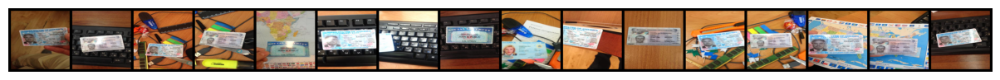

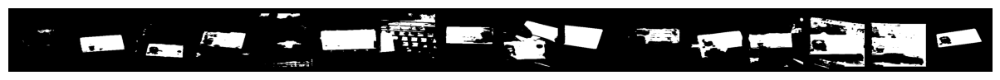

In [ ]:
show_valset_pred(model_miniunet, 16)

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

## Формат результата

Вычисленная по валидационной выборке метрика качества, либо ее график в WanDB или Tensorboard.

**Вывод: судя по графику лосс-функции на валидационной выборке, модель даже начала чему-то учиться**

# Задание 3. Сравнение моделей

- Импортируйте UNet из [SMP](https://github.com/qubvel/segmentation_models.pytorch#models), в качестве backbone используйте EfficientNet-b0.
- Обучите ее на том же датасете и с теми же гиперпараметрами, которые вы использовали во 2-м задании.
- Сравние целевую метрику для обоих моделей.
- Визуализируйте результаты сегментации.

Загрузите модель

In [ ]:
import torch
import segmentation_models_pytorch as smp
from segmentation_models_pytorch.encoders import get_preprocessing_fn
from IPython.display import clear_output

# 'mit_b0' Mix Vision Transformer Backbone from SegFormer pretrained on Imagenet
preprocess_input = get_preprocessing_fn("mit_b0", pretrained="imagenet")

# MixVisionTransformer encoder does not support in_channels setting other than 3
# supported by FPN only for encoder depth = 5
model = smp.FPN("mit_b0", in_channels=3, classes=10, encoder_depth=5)

# ... Train model on your dataset

dummy_input = torch.randn([1, 3, 64, 64])

mask = model(dummy_input)
clear_output()
print(mask.shape)  # torch.Size([1, 1, 64, 64])

torch.Size([1, 10, 64, 64])


In [ ]:
smp_unet = smp.Unet(encoder_name='efficientnet-b0', in_channels=3) # Your code here

In [ ]:
smp_unet

Unet(
  (encoder): EfficientNetEncoder(
    (_conv_stem): Conv2dStaticSamePadding(
      3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
      (static_padding): ZeroPad2d((0, 1, 0, 1))
    )
    (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
    (_blocks): ModuleList(
      (0): MBConvBlock(
        (_depthwise_conv): Conv2dStaticSamePadding(
          32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
          (static_padding): ZeroPad2d((1, 1, 1, 1))
        )
        (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
        (_se_reduce): Conv2dStaticSamePadding(
          32, 8, kernel_size=(1, 1), stride=(1, 1)
          (static_padding): Identity()
        )
        (_se_expand): Conv2dStaticSamePadding(
          8, 32, kernel_size=(1, 1), stride=(1, 1)
          (static_padding): Identity()
        )
        (_project_conv): Conv2dStaticSamePadding

При необходимости добавьте дополнительную предобработку данных

In [ ]:
# Your code here

Обучите

In [ ]:
logger_2 = TensorBoardLogger(save_dir='./logs', name='my_model_2')

In [ ]:
# Your code here
L.seed_everything(42)
model_smp_unet = smp_unet
lit_model_smp_unet = LitBasic(model_smp_unet)
trainer_smp = L.Trainer(logger=logger_2, max_epochs=15, log_every_n_steps=2)
trainer_smp.fit(model=lit_model_smp_unet, train_dataloaders=train_loader, val_dataloaders=val_loader)

INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO: 
  | Name      | Type              | Params
------------------------------------------------
0 | model     | Unet              | 6.3 M 
1 | criterion | BCEWithLogitsLoss | 0     
------------------------------------------------
6.3 M     Trainable params
0         Non-trainable params
6.3 M     Total params
25.006    Total estimated model params size (MB)
INFO:lightning.pytorch.callbacks.model_summary:
  | Name      | Type              | Params
-----------------

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.


Визуализируем результат для модели из 1-го задания

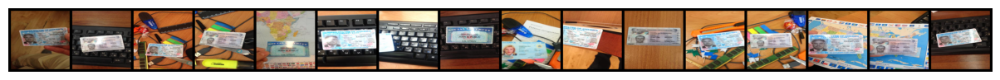

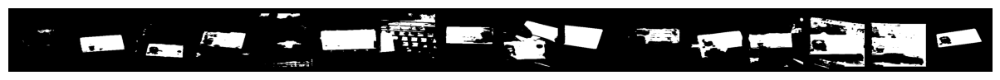

In [ ]:
show_valset_pred(model_miniunet, 16)

И для модели из SMP

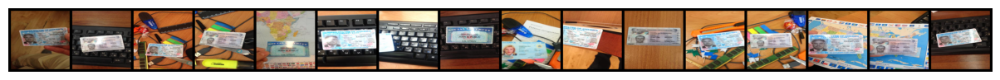

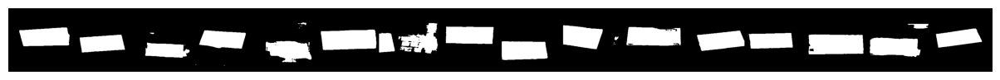

In [ ]:
show_valset_pred(model_smp_unet, 16)

In [ ]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 18096), started 0:08:29 ago. (Use '!kill 18096' to kill it.)

<IPython.core.display.Javascript object>

**Сравнивать my_model/version_1 и my_model_2/version_1**

## Формат результата

1. Графики целевой метрики для разных моделей. Предпочтительно в формате TB или WandB.



2. Сегментированные изображения документов

Пример изображения:

<img src ="https://edunet.kea.su/repo/EduNet-web_dependencies/dev-2.0/Exercises/EX11/result_1_task_ex11.png">



**Вывод: UNet из SMP обучается намного лучше, быстрее сходится к более низкому значению loss. По-видимому, это связано с большим размером модели (почти в 6 раз больше по памяти), применением BatchNorm и dropout'ов.**

# Задание 4.  YOLO на COCO датасете

1.  Используйте [SuperGradients](https://github.com/Deci-AI/super-gradients/) и самую быструю [модель](https://github.com/Deci-AI/super-gradients/blob/master/YOLONAS.md).
2. Убедитесь, что модель отрабатывает на произвольной картинке.
3. Используя [pycocotools](https://github.com/cocodataset/cocoapi.git), загрузите 5 первых изображений с велосипедами.
4. Проведите детектирование велосипедов при помощи YOLO.
5. Выведите картинки с наложенными на них BoundingBox: детектированные YOLO — красным цветом, разметку из COCO — зеленым.
6. Оцените точность детектирования по метрике [AP](https://cocodataset.org/#detection-eval), используя  [cocoEval.evaluate](https://github.com/cocodataset/cocoapi/blob/master/PythonAPI/pycocotools/cocoeval.py).

##  Загрузите YOLO


Установите пакет super_gradients:

In [ ]:
from IPython.display import clear_output

!pip install -q super_gradients
clear_output()

Создайте самый легий [вариант модели](https://github.com/Deci-AI/super-gradients/blob/master/YOLONAS.md)

In [ ]:
!wget -q https://github.com/ultralytics/assets/releases/download/v0.0.0/yolo_nas_s.pt

In [ ]:
from super_gradients.training import models
from super_gradients.common.object_names import Models

clear_output()

In [ ]:
yolo = models.get(Models.YOLO_NAS_S, pretrained_weights="coco")# Your code here

[2023-12-26 15:41:16] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_s_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_s_coco.pth
100%|██████████| 73.1M/73.1M [00:00<00:00, 191MB/s]
[2023-12-26 15:41:17] INFO - checkpoint_utils.py - Successfully loaded pretrained weights for architecture yolo_nas_s


## Smoke test

Убедитесь, что модель отрабатывает на произвольной картинке.

In [ ]:
from PIL import Image

! wget -qO cat.png https://edunet.kea.su/repo/EduNet-web_dependencies/dev-2.0/Exercises/EX11/semantic_segmentation.png

img = Image.open("/content/cat.png")

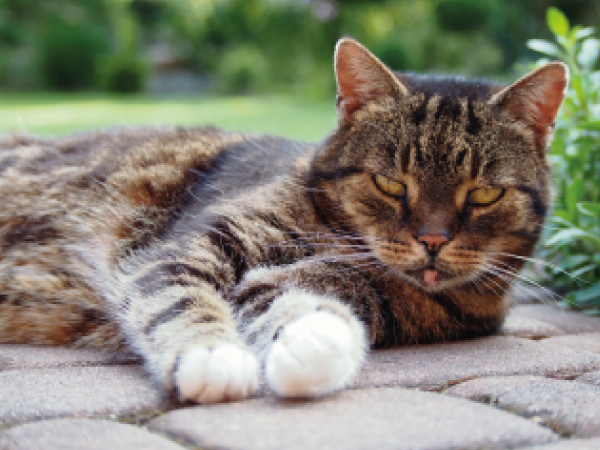

In [ ]:
display(img)

In [ ]:
result = yolo.predict(img)

[2023-12-26 15:41:28] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


In [ ]:
result

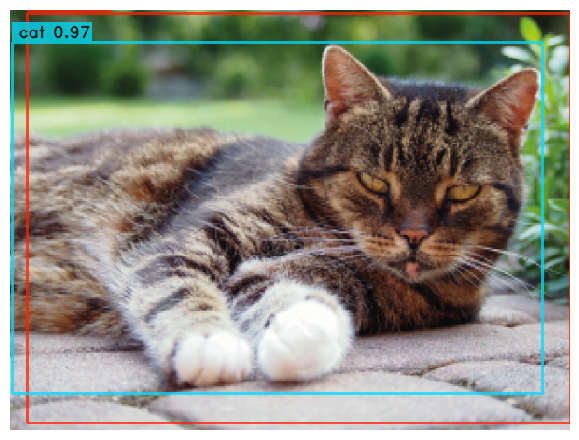

In [ ]:
result.show()

## Загрузка данных

Загрузите 5 первых изображений с велосипедами из COCO

*  Используйте [pycocotools](https://github.com/cocodataset/cocoapi.git)
*  Выведите загруженные изображения

In [ ]:
# !wget -qN "http://images.cocodataset.org/annotations/annotations_trainval2017.zip"
!wget -qN "https://edunet.kea.su/repo/EduNet-web_dependencies/datasets/annotations_trainval2017.zip"
!unzip -qn annotations_trainval2017.zip

In [ ]:
from pycocotools.coco import COCO
coco = COCO("annotations/instances_val2017.json")
bicycleIds = coco.getCatIds(catNms=['bicycle'])  #  Find category ID by tag
print("class ID(bicycle) =", bicycleIds)

imgIds = coco.getImgIds(catIds=bicycleIds)  # Filtering dataset by category ID
print("All images: %i" % len(imgIds))
# Your code here

loading annotations into memory...


In [ ]:
img_list = coco.loadImgs(imgIds)
img_metadata = img_list[:5]
img_metadata

[{'license': 4,
  'file_name': '000000184324.jpg',
  'coco_url': 'http://images.cocodataset.org/val2017/000000184324.jpg',
  'height': 425,
  'width': 640,
  'date_captured': '2013-11-17 05:31:28',
  'flickr_url': 'http://farm4.staticflickr.com/3568/3364389746_361655c747_z.jpg',
  'id': 184324},
 {'license': 2,
  'file_name': '000000546823.jpg',
  'coco_url': 'http://images.cocodataset.org/val2017/000000546823.jpg',
  'height': 480,
  'width': 640,
  'date_captured': '2013-11-18 20:39:29',
  'flickr_url': 'http://farm3.staticflickr.com/2336/2346306710_d25a24fda5_z.jpg',
  'id': 546823},
 {'license': 3,
  'file_name': '000000343561.jpg',
  'coco_url': 'http://images.cocodataset.org/val2017/000000343561.jpg',
  'height': 428,
  'width': 640,
  'date_captured': '2013-11-15 04:22:48',
  'flickr_url': 'http://farm5.staticflickr.com/4118/4812500977_6b1c83b5c4_z.jpg',
  'id': 343561},
 {'license': 6,
  'file_name': '000000169996.jpg',
  'coco_url': 'http://images.cocodataset.org/val2017/00000

In [ ]:
import matplotlib.pyplot as plt
import requests
from PIL import Image
from io import BytesIO


def coco2pil(url):
    response = requests.get(url)
    return Image.open(BytesIO(response.content))

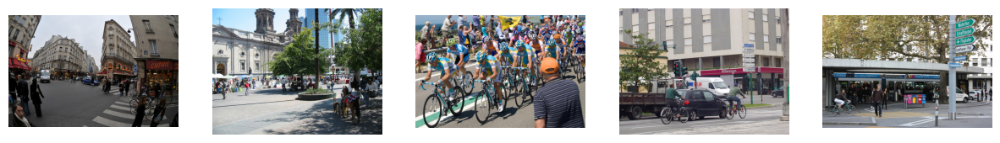

In [ ]:
fig, axs = plt.subplots(1, 5, figsize=(15, 10))
for i in range(5):
  I = coco2pil(img_metadata[i]["coco_url"])
  axs[i].axis("off")
  axs[i].imshow(I)

## Детектирование

Детектируйте на загруженных картинках велосипеды при помощи YOLO.

Затем выведите предсказанные YOLO bbox красным цветом, а разметку из COCO — зеленым цветом.

https://pytorch.org/vision/stable/utils.html

## Формат результата

<img src ="https://edunet.kea.su/repo/EduNet-web_dependencies/dev-2.0/Exercises/EX11/result_4_task_ex11.png" width="400">






In [ ]:
# Your code here

## Дополнительно: оценка качества

Оцените точность детектирования по метрике mAP, используя [cocoEval.evaluate](https://github.com/cocodataset/cocoapi/blob/master/PythonAPI/pycocotools/cocoeval.py), или пакет [SMP](https://github.com/qubvel/segmentation_models.pytorch), или [Torchmetrics](https://torchmetrics.readthedocs.io/en/stable/).

### Формат результата


Значения AP:

```
Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.098
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.259
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.102
 ...
```


In [ ]:
# Your code here